# Style transfer using GAN
This notebook will be used to prepare the capstone project 'Style transfer using GAN'

In [1]:
#Import all the required libraries
import tensorflow as tf
import matplotlib.pyplot as plt
import glob # to find certain directories
import imageio
from IPython import display
from skimage.transform import resize
import numpy as np
import os # to access the folders and files
from keras.utils.vis_utils import plot_model

import numpy as np
#import cv2
import skimage.transform as st
import os

from skimage.io import imread
import random

from pathlib import Path

from skimage.io import imread_collection

Using TensorFlow backend.


#### Define the paths for T1 and T2

In [2]:
T1_path = './dataset/Tr1/TrainT1'
T2_path = './dataset/Tr2/TrainT2'

#### Function to load the images from both T1 and T2 directories

In [3]:
def load_images_from_folder(path):
    _dir= path+'/*.png'
    col = imread_collection(_dir)
    return col

#### Function to plot random images from the training sets of T1 and T2

In [4]:
def plot_images(image_collection):
    fig = plt.figure()
    
    f, axs = plt.subplots(1,4,figsize=(8,8))
    
    plt.subplot(1,4,1)
    index = random.randint(0,34)
    ax1=plt.imshow(image_collection[index],cmap='gray')
    plt.title(str(index))
    plt.axis('off')
    
    plt.subplot(1,4,2)
    index = random.randint(0,34)
    ax1=plt.imshow(image_collection[index],cmap='gray')
    plt.title(str(index))
    plt.axis('off')    
    
    plt.subplot(1,4,3)
    index = random.randint(0,34)
    ax1=plt.imshow(image_collection[index],cmap='gray')
    plt.title(str(index))
    plt.axis('off')
    
    plt.subplot(1,4,4)
    index = random.randint(0,34)
    ax1=plt.imshow(image_collection[index],cmap='gray')
    plt.title(str(index))
    plt.axis('off')
    
    plt.show()

#### Create datasets from respective image directories

In [5]:
tr1 = np.array(load_images_from_folder(T1_path)) 
tr2 = np.array(load_images_from_folder(T2_path))

### Data understanding
Import the images & create two seperate datasets. The input shape for image should be (128,128)


In [6]:
print('Number of T1 MRI images - ', len(tr1))
print('Number of T2 MRI images - ', len(tr2))

Number of T1 MRI images -  43
Number of T2 MRI images -  46


#### Function `train_test_split` to set some images aside for testing the generators

In [7]:
def train_test_split(dataset,sizee):
    training_idx = np.random.randint(dataset.shape[0],size=sizee)
    test_idx = np.random.randint(dataset.shape[0],size = len(dataset)-sizee)
    training, test = dataset[training_idx,:], dataset[test_idx,:]
    return training,test
    

In [8]:
tr1_training, tr1_test = train_test_split(tr1,35)
tr2_training,tr2_test = train_test_split(tr2,37)

In [9]:
print('T1 training Shape - ',tr1_training.shape)
print('T2 training Shape - ',tr2_training.shape)
print('T1 test Shape - ',tr1_test.shape)
print('T2 test Shape - ',tr2_test.shape)


T1 training Shape -  (35, 217, 181)
T2 training Shape -  (37, 217, 181)
T1 test Shape -  (8, 217, 181)
T2 test Shape -  (9, 217, 181)


***Plotting sample 4 images of type T1***

<Figure size 432x288 with 0 Axes>

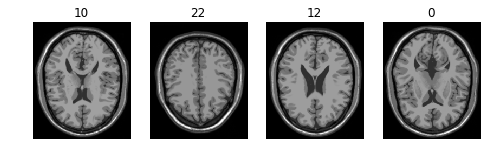

In [10]:
plot_images(tr1_training)

***Plotting sample 4 images of type T2***

<Figure size 432x288 with 0 Axes>

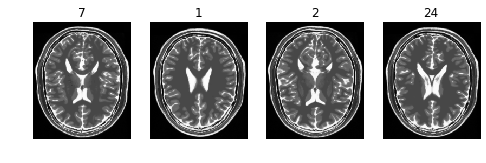

In [11]:
plot_images(tr2_training)

## Image Processing 
1.Create a function to process your images with normalisation

2.Apply the function to both the datasets 

3.Visualise the MRI images after processing




#### Normalize the image so that the values are between -1.0 and 1.0

In [12]:
def normalize(dataset):
    return (dataset/127.5)-1.0

In [13]:
tr1_training_normalized = normalize(tr1_training)
tr2_training_normalized = normalize(tr2_training)
tr1_test_normalized = normalize(tr1_test)
tr2_test_normalized = normalize(tr2_test)

#### `tr1_training_normalized`, `tr2_training_normalized`, `tr1_test_normalized` and `tr2_test_normalized` have the normalized training images.

#### Function `resize_datasets` is used to resize the images from (217,181) to (128,128)

In [14]:
def resize_datasets(dataset):
    resized = np.zeros((len(dataset),128,128))
    for i,image in enumerate(dataset):
        resized[i,:,:]= st.resize(image,output_shape=(128,128))
    return resized

In [15]:
tr1_training_resized = resize_datasets(tr1_training_normalized)
tr2_training_resized = resize_datasets(tr2_training_normalized)
tr1_test_resized = resize_datasets(tr1_test_normalized)
tr2_test_resized = resize_datasets(tr2_test_normalized)

/mnt/disks/user/anaconda3/lib/python3.7/site-packages/skimage/transform/_warps.py:105: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/mnt/disks/user/anaconda3/lib/python3.7/site-packages/skimage/transform/_warps.py:110: UserWarning: Anti-aliasing will be enabled by default in skimage 0.15 to avoid aliasing artifacts when down-sampling images.
  warn("Anti-aliasing will be enabled by default in skimage 0.15 to "


In [16]:
print('T1 training_resized Shape - ',tr1_training_resized.shape)
print('T2 training_resized Shape - ',tr2_training_resized.shape)
print('T1 test_resized Shape - ',tr1_test_resized.shape)
print('T2 test_resized Shape - ',tr2_test_resized.shape)

T1 training_resized Shape -  (35, 128, 128)
T2 training_resized Shape -  (37, 128, 128)
T1 test_resized Shape -  (8, 128, 128)
T2 test_resized Shape -  (9, 128, 128)


In [17]:
tr1_training_resized =tf.cast(tr1_training_resized.reshape(tr1_training_resized.shape[0],128,128,1),tf.float32)
tr2_training_resized = tf.cast(tr2_training_resized.reshape(tr2_training_resized.shape[0],128,128,1),tf.float32)

tr1_test_resized =tf.cast(tr1_test_resized.reshape(tr1_test_resized.shape[0],128,128,1),tf.float32)
tr2_test_resized = tf.cast(tr2_test_resized.reshape(tr2_test_resized.shape[0],128,128,1),tf.float32)

#### Take the sample images from tr1_resized to plot and visualize the pick later

In [18]:
sample_tr1_resized = next(iter(tr1_training_resized))
sample_tr2_resized = next(iter(tr2_training_resized))

In [19]:
sample_tr1_resized=tf.reshape(sample_tr1_resized,(128,128))
sample_tr2_resized=tf.reshape(sample_tr2_resized,(128,128))

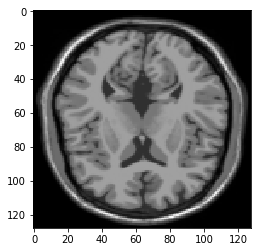

In [20]:
plt.imshow(sample_tr1_resized,cmap='gray')

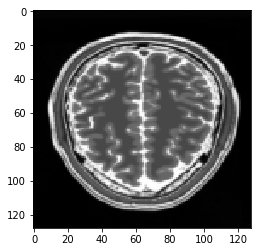

In [21]:
plt.imshow(sample_tr2_resized,cmap='gray')

#### Define the batch size and the epochs

In [22]:
batchsize = 3
epochs = 100

#### Get the data ready in the form of batches by using `from_tensor_slices()` function

In [23]:
tr1_training_resized = tf.data.Dataset.from_tensor_slices(tr1_training_resized).shuffle(tr1_training_normalized.shape[0],seed=42).batch(batchsize)
tr2_training_resized = tf.data.Dataset.from_tensor_slices(tr2_training_resized).shuffle(tr2_training_normalized.shape[0],seed=42).batch(batchsize)

tr1_test_resized = tf.data.Dataset.from_tensor_slices(tr1_test_resized).shuffle(tr1_test_normalized.shape[0],seed=42).batch(batchsize)
tr2_test_resized = tf.data.Dataset.from_tensor_slices(tr2_test_resized).shuffle(tr2_test_normalized.shape[0],seed=42).batch(batchsize)

#### Plot one of the images of both T1 and T2 types

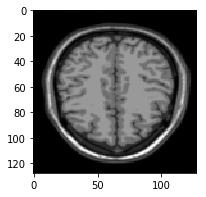

In [24]:
sample_tr1_training = next(iter(tr1_training_resized))
plt.figure(figsize=(3,3))
plt.imshow(sample_tr1_training[0].numpy()[:,:,0],cmap='gray')
plt.show()

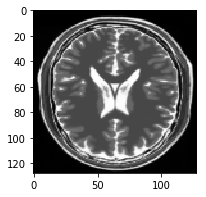

In [25]:
sample_tr2_training = next(iter(tr2_training_resized))
plt.figure(figsize=(3,3))
plt.imshow(sample_tr2_training[0].numpy()[:,:,0],cmap='gray')
plt.show()

## Model Building & Training
The architecture of generator is a modified U-Net.

1.Create your Generator & Discriminator

2.Define the loss functions

3.Create the train_step function

#### We will be using `InstanceNormalization` for this problem statement as this is proved to be more efficient

In [26]:
class InstanceNormalization(tf.keras.layers.Layer):
    def __init__(self, epsilon=1e-5):
        super(InstanceNormalization, self).__init__()
        self.epsilon = epsilon
    def build(self, input_shape):
        self.scale = self.add_weight(
            name='scale',
            shape=input_shape[-1:],
            initializer=tf.random_normal_initializer(1., 0.02),
            trainable=True)
        self.offset = self.add_weight(
            name='offset',
            shape=input_shape[-1:],
            initializer='zeros',
            trainable=True)
    def call(self, x):
        mean, variance = tf.nn.moments(x, axes=[1, 2], keepdims=True)
        inv = tf.math.rsqrt(variance + self.epsilon)
        normalized = (x - mean) * inv
        return self.scale * normalized + self.offset



#### Defining `upsample()` and `downsample` which will be used in the `unet_generator` for upsampling and downsampling respectively

In [27]:
def downsample(filters, size, apply_norm=True):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                                      kernel_initializer=initializer, use_bias=False))
    if apply_norm:
        result.add(InstanceNormalization())
    result.add(tf.keras.layers.LeakyReLU())
    return result

def upsample(filters, size, apply_dropout=False):
    initializer = tf.random_normal_initializer(0., 0.02)
    result = tf.keras.Sequential()
    result.add(tf.keras.layers.Conv2DTranspose(filters, size, strides=2, padding='same',
                                               kernel_initializer=initializer, use_bias=False))
    result.add(InstanceNormalization())
    if apply_dropout:
        result.add(tf.keras.layers.Dropout(0.5))
    result.add(tf.keras.layers.ReLU())
    return result

#### Define `unet_generator()` to generate required dimensions images from generators

In [28]:
def unet_generator_128():
    down_stack = [
        downsample(64,4,False),
        downsample(128,4),
        downsample(128,4),
        downsample(128,4),
        downsample(128,4)]
    up_stack = [
        upsample(128,4,True),
        upsample(128,4,True),
        upsample(128,4),
        upsample(64,4)]
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 128, 128, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[128, 128, 1])
    x = inputs
    # Downsampling through the model
    #print(x)
    skips = []
    for down in down_stack:
        x = down(x)
        #print(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        #print(x)
        #print('skip =',skip)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

create two generator objects to create a ***cycle***

In [29]:
generator_g_128 = unet_generator_128()#initialise the generator
generator_f_128 = unet_generator_128()#initialise the generator

Print out the summary of one of the generators

In [30]:
generator_g_128.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 128, 128, 1) 0                                            
__________________________________________________________________________________________________
sequential (Sequential)         (None, 64, 64, 64)   1024        input_1[0][0]                    
__________________________________________________________________________________________________
sequential_1 (Sequential)       (None, 32, 32, 128)  131328      sequential[0][0]                 
__________________________________________________________________________________________________
sequential_2 (Sequential)       (None, 16, 16, 128)  262400      sequential_1[0][0]               
______________________________________________________________________________________________

Define descriminator which will be ther adversary for the generators and create two instances of the same

In [31]:
def discriminator():
    initializer = tf.random_normal_initializer(0., 0.02)
    inp = tf.keras.layers.Input(shape=[None, None, 1], name='input_image')
    x = inp
    down1 = downsample(64, 4, False)(x) # (bs, 16, 16, 64)
    down2 = downsample(128, 4)(down1) # (bs, 8, 8, 128)
    down3 = downsample(128,4)(down2)#write your code to downsample down2
    zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3) # (bs, 34, 34, 256)
    conv = tf.keras.layers.Conv2D(512, 4, strides=1, kernel_initializer=initializer,
                                  use_bias=False)(zero_pad1) # (bs, 31, 31, 512)
    norm1 = InstanceNormalization()(conv)
    leaky_relu = tf.keras.layers.LeakyReLU()(norm1)
    zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu) # (bs, 33, 33, 512)
    last = tf.keras.layers.Conv2D(1, 4, strides=1, kernel_initializer=initializer)(zero_pad2) # (bs, 30, 30, 1)
    return tf.keras.Model(inputs=inp, outputs=last)#create the model using input & output layer

In [32]:
discriminator_x = discriminator()#initialise the discriminator
discriminator_y = discriminator()#initialise the discriminator

In [33]:
discriminator_x.summary()

Model: "model_2"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_image (InputLayer)     [(None, None, None, 1)]   0         
_________________________________________________________________
sequential_18 (Sequential)   (None, None, None, 64)    1024      
_________________________________________________________________
sequential_19 (Sequential)   (None, None, None, 128)   131328    
_________________________________________________________________
sequential_20 (Sequential)   (None, None, None, 128)   262400    
_________________________________________________________________
zero_padding2d (ZeroPadding2 (None, None, None, 128)   0         
_________________________________________________________________
conv2d_13 (Conv2D)           (None, None, None, 512)   1048576   
_________________________________________________________________
instance_normalization_18 (I (None, None, None, 512)   1024

Take images from T1 and T2 to create base noise image which will be tuned later when the actual training happens

In [34]:
sample_training_1 = next(iter(tr1_training_resized))
sample_training_2 =  next(iter(tr2_training_resized))

In [35]:
sample_test_1 = next(iter(tr1_test_resized))
sample_test_2 =  next(iter(tr2_test_resized))

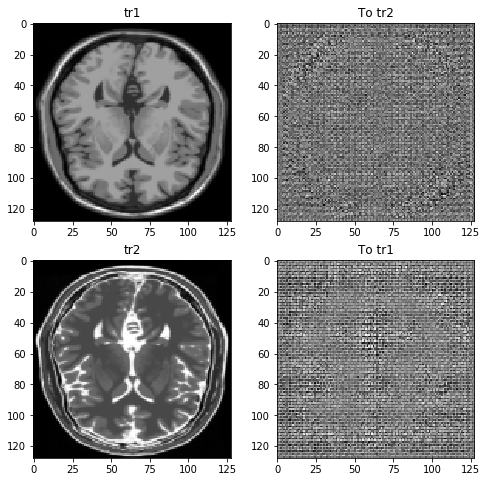

In [36]:
to_tr2 = generator_g_128(sample_training_1)
to_tr1 = generator_f_128(sample_training_2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_training_1, to_tr2, sample_training_2, to_tr1]
title = ['tr1', 'To tr2', 'tr2', 'To tr1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()

Set lambda and loss objective function which is BinaryCrossentropy in our case

In [37]:
LAMBDA = 0.5
loss_obj = tf.keras.losses.BinaryCrossentropy(from_logits=True)

#### Define discriminator_loss, generator_loss, calc_cycle_loss, identity_loss

In [38]:
def discriminator_loss(real, generated):
    real_loss = loss_obj(tf.ones_like(real), real)#write your code here
    generated_loss = loss_obj(tf.zeros_like(generated), generated)#write your code here
    total_disc_loss =real_loss + generated_loss #write your code here
    return total_disc_loss * 0.5

In [39]:
def generator_loss(generated):
    return loss_obj(tf.ones_like(generated),generated)

In [40]:
def calc_cycle_loss(real_image, cycled_image):
    loss1 = tf.reduce_mean(tf.abs(real_image - cycled_image))
    return LAMBDA * loss1

In [41]:
def identity_loss(real_image, same_image):
    loss = tf.reduce_mean(tf.abs(real_image, same_image))
    return LAMBDA * 0.5 * loss

#### Using Adam optimizer for both the generators and the discriminators

In [42]:
generator_g_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
generator_f_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

discriminator_x_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_y_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

#### Create checkpoints to later recover if the training is stopped for any reason

In [43]:
checkpoint_path = './training_checkpoints/CycleGAN_128/'

ckpt = tf.train.Checkpoint(generator_g=generator_g_128,
                           generator_f=generator_f_128,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=epochs)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

#### `generate_images` is used to plot the images while we are training the generators, we can see the progress and transformation of the images from one type to another type and save the images to the `Outputs` directory

In [44]:
def generate_images(model1, test_input1,model2,test_input2,epoch):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(10, 10))
    display_list = [test_input1[0], prediction1[0], test_input2[0],prediction2[0]]
    title = ['Input Image T1', 'Predicted Image T2','Input Image T2', 'Predicted Image T1']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
        plt.axis('off')
        #plt.savefig('./Outputs/epoch_'+str(epoch)+'.png')
#create Outputs_128 if it does not exist
    Path("Outputs_128").mkdir(parents=True, exist_ok=True)
    if epoch is None:
        pass
    else:
        plt.savefig('./Outputs_128/epoch_'+str(epoch)+'.png',dpi=100)
    plt.show()


#### Define a `train_step` to perform one step of training

In [45]:
def train_step(real_x, real_y):
# Persistance is set to  true because the tape is used more than
# once to calculate the gradients
    with tf.GradientTape(persistent=True) as tape:
# Generate Fake Y and Cycled X
        fake_y = generator_g_128(real_x, training=True)
        cycled_x = generator_f_128(fake_y, training=True)

        # Generate Fake X and Cycled Y
        fake_x = generator_f_128(real_y, training=True)
        cycled_y = generator_g_128(fake_x, training=True)

        # Generate Fake Images through G and F for Identity Loss.
        same_x = generator_f_128(real_x, training=True)
        same_y = generator_g_128(real_y, training=True)

        # Calculate Discriminator prediction using DX and DY on real and fake data for loss calculation.
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # Calculate Generator Loss on Discriminator.
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        # Calculate Cycled Loss on Cycled Images from step 1 and 2.
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

        # Calculate Total Generator Loss →  Disc Loss + Cycled Loss + Identity Loss.
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        # Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

# Calculate the Gradients for generator and discriminator
        generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g_128.trainable_variables)
        generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f_128.trainable_variables)

        discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
        discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

        # Apply the gradients to the optimizer
        generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g_128.trainable_variables))
        generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f_128.trainable_variables))

        discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
        discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

#### Below results are for 128*128 images

W0413 19:14:50.984047 139884799817536 backprop.py:1014] Calling GradientTape.gradient on a persistent tape inside its context is significantly less efficient than calling it outside the context (it causes the gradient ops to be recorded on the tape, leading to increased CPU and memory usage). Only call GradientTape.gradient inside the context if you actually want to trace the gradient in order to compute higher order derivatives.
W0413 19:14:51.360244 139884799817536 backprop.py:1014] Calling GradientTape.gradient on a persistent tape inside its context is significantly less efficient than calling it outside the context (it causes the gradient ops to be recorded on the tape, leading to increased CPU and memory usage). Only call GradientTape.gradient inside the context if you actually want to trace the gradient in order to compute higher order derivatives.
W0413 19:14:51.501322 139884799817536 backprop.py:1014] Calling GradientTape.gradient on a persistent tape inside its context is sig

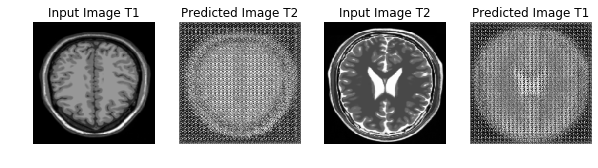

Saving checkpoint for epoch 0 at ./training_checkpoints/CycleGAN_128/ckpt-1


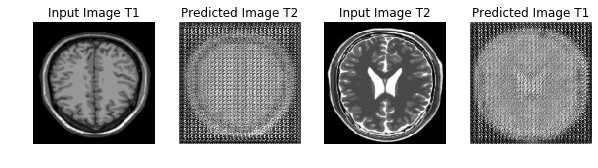

Saving checkpoint for epoch 1 at ./training_checkpoints/CycleGAN_128/ckpt-2


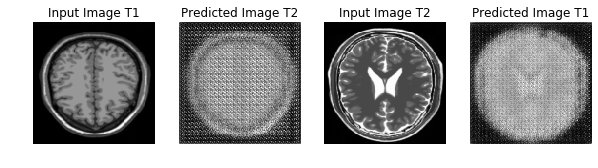

Saving checkpoint for epoch 2 at ./training_checkpoints/CycleGAN_128/ckpt-3


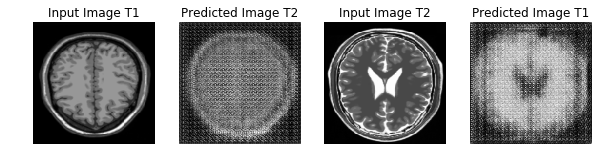

Saving checkpoint for epoch 3 at ./training_checkpoints/CycleGAN_128/ckpt-4


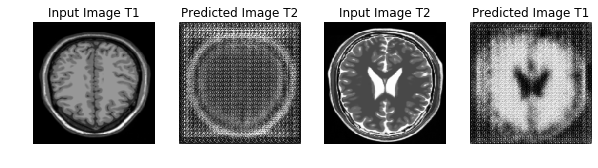

Saving checkpoint for epoch 4 at ./training_checkpoints/CycleGAN_128/ckpt-5


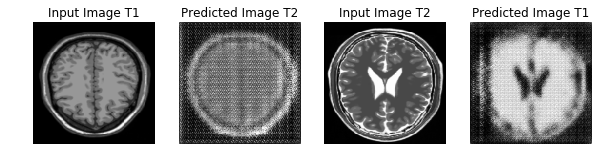

Saving checkpoint for epoch 5 at ./training_checkpoints/CycleGAN_128/ckpt-6


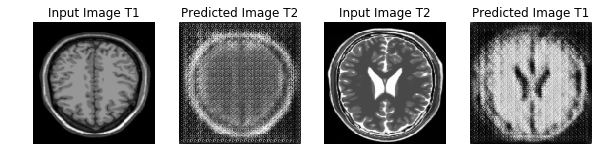

Saving checkpoint for epoch 6 at ./training_checkpoints/CycleGAN_128/ckpt-7


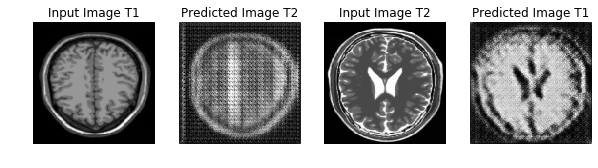

Saving checkpoint for epoch 7 at ./training_checkpoints/CycleGAN_128/ckpt-8


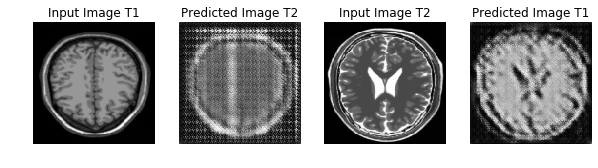

Saving checkpoint for epoch 8 at ./training_checkpoints/CycleGAN_128/ckpt-9


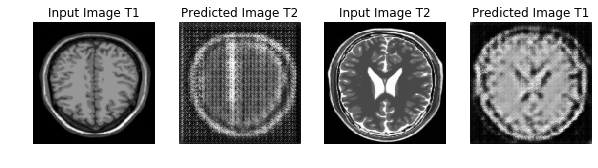

Saving checkpoint for epoch 9 at ./training_checkpoints/CycleGAN_128/ckpt-10


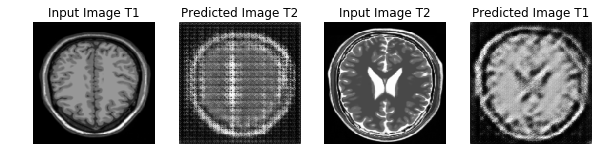

Saving checkpoint for epoch 10 at ./training_checkpoints/CycleGAN_128/ckpt-11


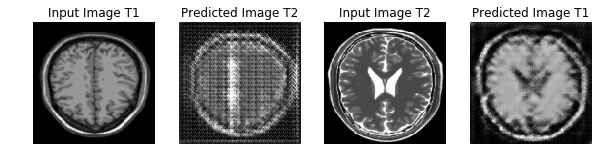

Saving checkpoint for epoch 11 at ./training_checkpoints/CycleGAN_128/ckpt-12


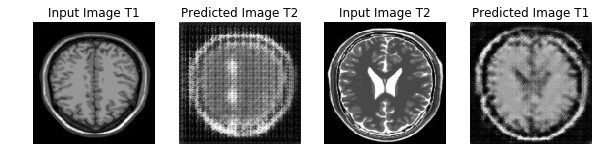

Saving checkpoint for epoch 12 at ./training_checkpoints/CycleGAN_128/ckpt-13


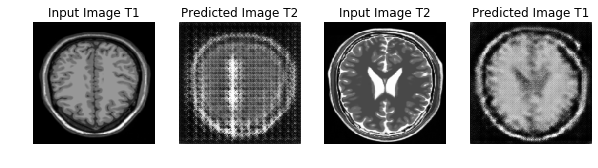

Saving checkpoint for epoch 13 at ./training_checkpoints/CycleGAN_128/ckpt-14


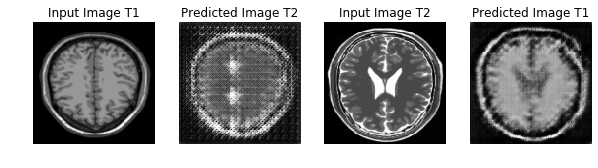

Saving checkpoint for epoch 14 at ./training_checkpoints/CycleGAN_128/ckpt-15


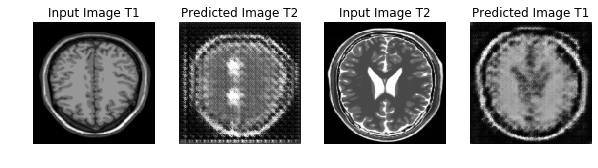

Saving checkpoint for epoch 15 at ./training_checkpoints/CycleGAN_128/ckpt-16


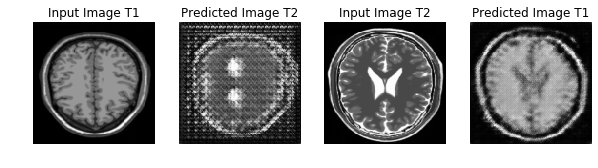

Saving checkpoint for epoch 16 at ./training_checkpoints/CycleGAN_128/ckpt-17


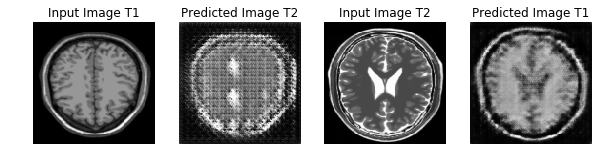

Saving checkpoint for epoch 17 at ./training_checkpoints/CycleGAN_128/ckpt-18


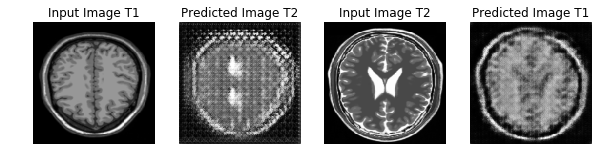

Saving checkpoint for epoch 18 at ./training_checkpoints/CycleGAN_128/ckpt-19


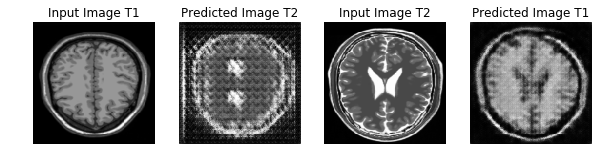

Saving checkpoint for epoch 19 at ./training_checkpoints/CycleGAN_128/ckpt-20


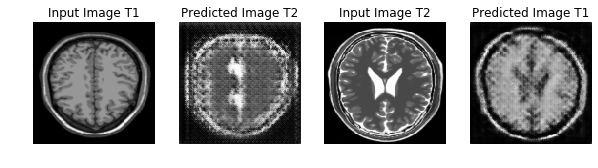

Saving checkpoint for epoch 20 at ./training_checkpoints/CycleGAN_128/ckpt-21


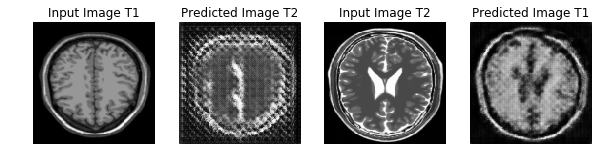

Saving checkpoint for epoch 21 at ./training_checkpoints/CycleGAN_128/ckpt-22


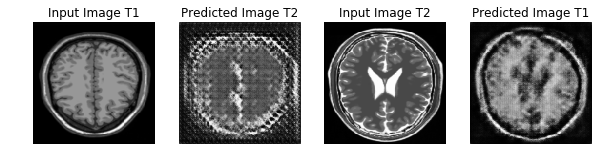

Saving checkpoint for epoch 22 at ./training_checkpoints/CycleGAN_128/ckpt-23


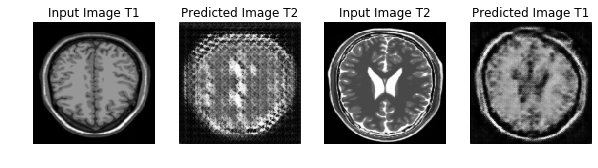

Saving checkpoint for epoch 23 at ./training_checkpoints/CycleGAN_128/ckpt-24


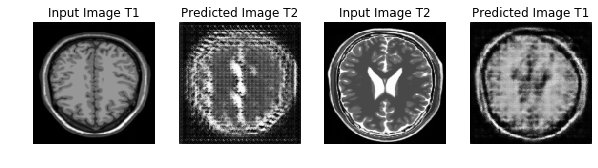

Saving checkpoint for epoch 24 at ./training_checkpoints/CycleGAN_128/ckpt-25


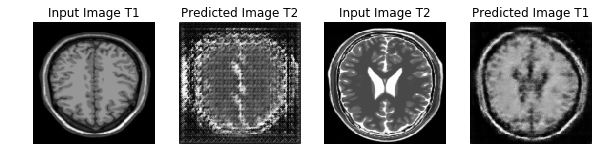

Saving checkpoint for epoch 25 at ./training_checkpoints/CycleGAN_128/ckpt-26


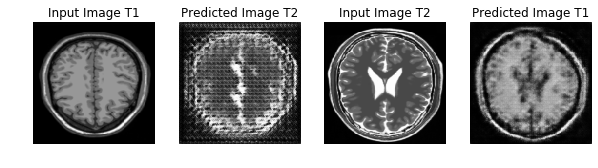

Saving checkpoint for epoch 26 at ./training_checkpoints/CycleGAN_128/ckpt-27


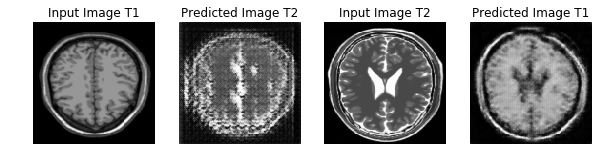

Saving checkpoint for epoch 27 at ./training_checkpoints/CycleGAN_128/ckpt-28


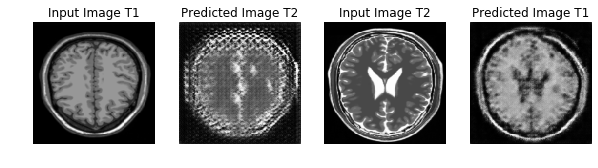

Saving checkpoint for epoch 28 at ./training_checkpoints/CycleGAN_128/ckpt-29


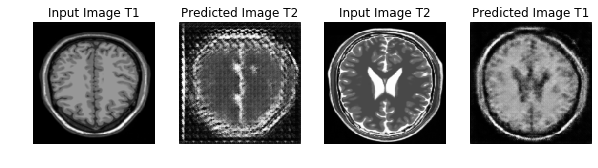

Saving checkpoint for epoch 29 at ./training_checkpoints/CycleGAN_128/ckpt-30


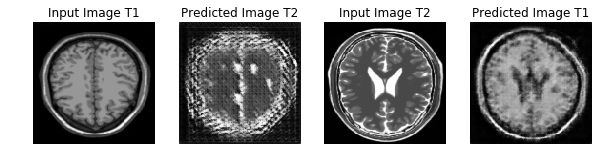

Saving checkpoint for epoch 30 at ./training_checkpoints/CycleGAN_128/ckpt-31


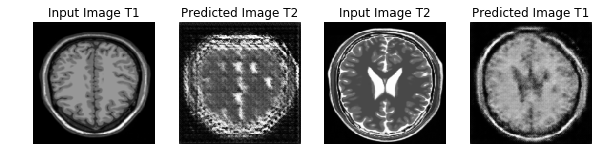

Saving checkpoint for epoch 31 at ./training_checkpoints/CycleGAN_128/ckpt-32


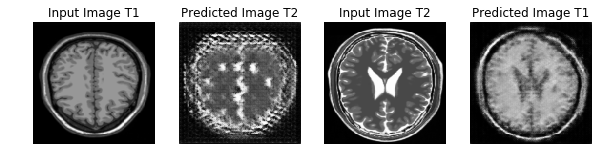

Saving checkpoint for epoch 32 at ./training_checkpoints/CycleGAN_128/ckpt-33


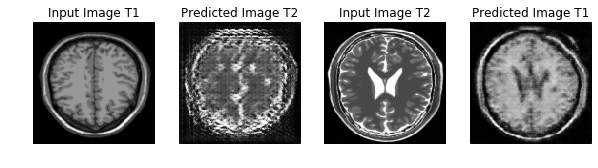

Saving checkpoint for epoch 33 at ./training_checkpoints/CycleGAN_128/ckpt-34


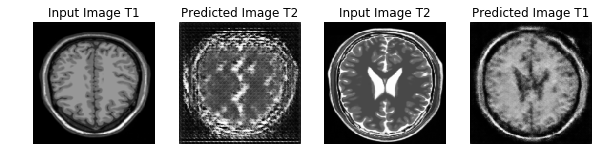

Saving checkpoint for epoch 34 at ./training_checkpoints/CycleGAN_128/ckpt-35


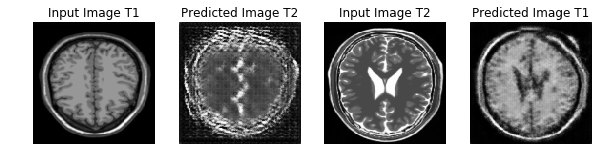

Saving checkpoint for epoch 35 at ./training_checkpoints/CycleGAN_128/ckpt-36


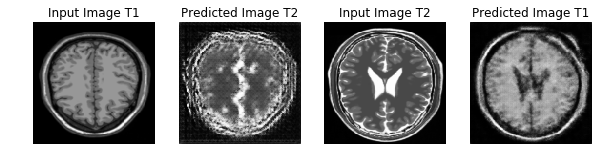

Saving checkpoint for epoch 36 at ./training_checkpoints/CycleGAN_128/ckpt-37


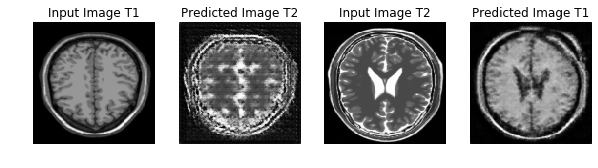

Saving checkpoint for epoch 37 at ./training_checkpoints/CycleGAN_128/ckpt-38


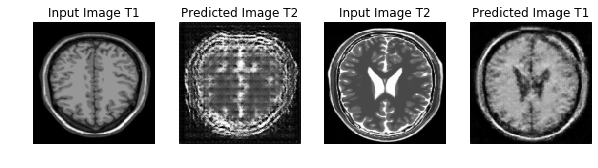

Saving checkpoint for epoch 38 at ./training_checkpoints/CycleGAN_128/ckpt-39


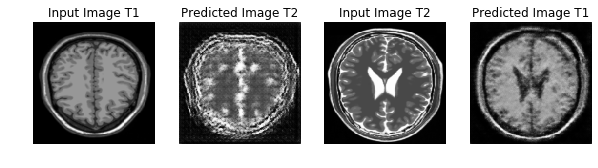

Saving checkpoint for epoch 39 at ./training_checkpoints/CycleGAN_128/ckpt-40


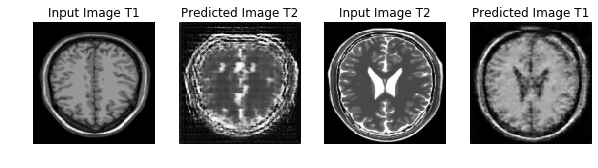

Saving checkpoint for epoch 40 at ./training_checkpoints/CycleGAN_128/ckpt-41


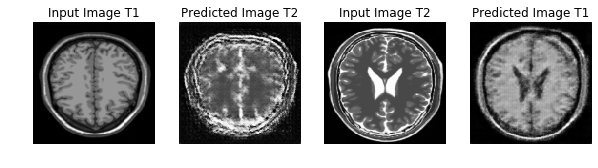

Saving checkpoint for epoch 41 at ./training_checkpoints/CycleGAN_128/ckpt-42


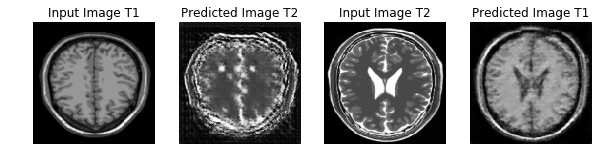

Saving checkpoint for epoch 42 at ./training_checkpoints/CycleGAN_128/ckpt-43


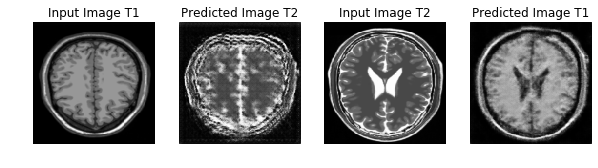

Saving checkpoint for epoch 43 at ./training_checkpoints/CycleGAN_128/ckpt-44


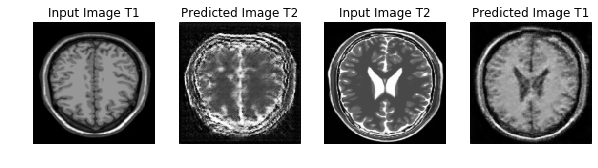

Saving checkpoint for epoch 44 at ./training_checkpoints/CycleGAN_128/ckpt-45


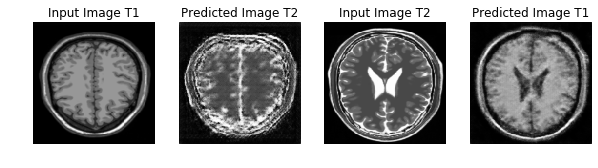

Saving checkpoint for epoch 45 at ./training_checkpoints/CycleGAN_128/ckpt-46


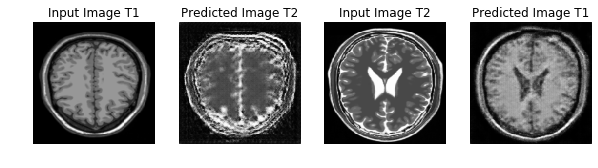

Saving checkpoint for epoch 46 at ./training_checkpoints/CycleGAN_128/ckpt-47


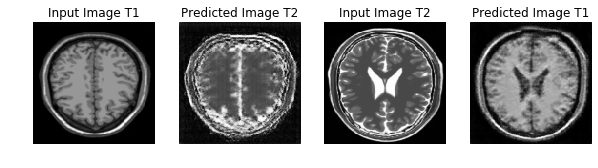

Saving checkpoint for epoch 47 at ./training_checkpoints/CycleGAN_128/ckpt-48


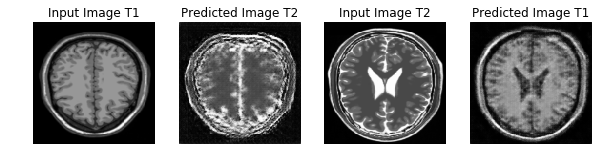

Saving checkpoint for epoch 48 at ./training_checkpoints/CycleGAN_128/ckpt-49


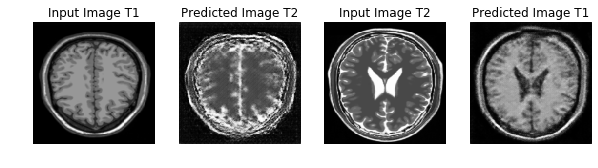

Saving checkpoint for epoch 49 at ./training_checkpoints/CycleGAN_128/ckpt-50


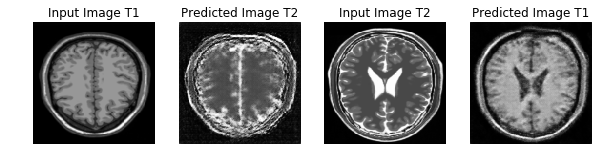

Saving checkpoint for epoch 50 at ./training_checkpoints/CycleGAN_128/ckpt-51


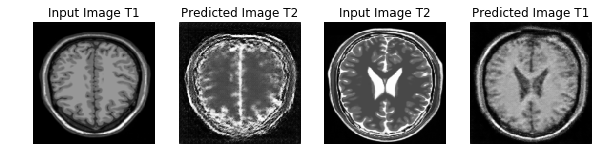

Saving checkpoint for epoch 51 at ./training_checkpoints/CycleGAN_128/ckpt-52


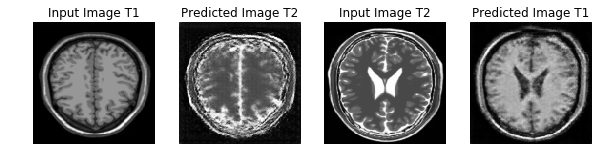

Saving checkpoint for epoch 52 at ./training_checkpoints/CycleGAN_128/ckpt-53


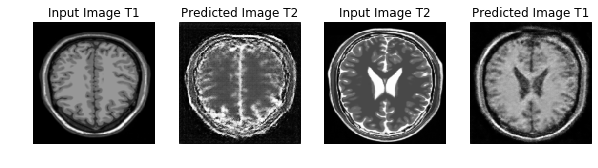

Saving checkpoint for epoch 53 at ./training_checkpoints/CycleGAN_128/ckpt-54


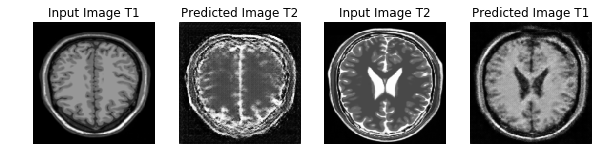

Saving checkpoint for epoch 54 at ./training_checkpoints/CycleGAN_128/ckpt-55


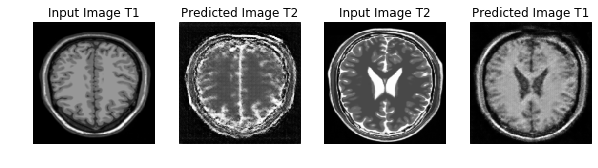

Saving checkpoint for epoch 55 at ./training_checkpoints/CycleGAN_128/ckpt-56


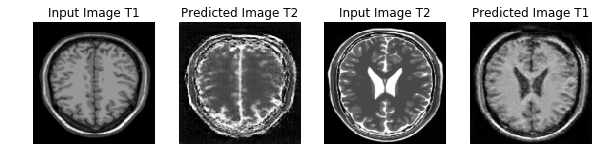

Saving checkpoint for epoch 56 at ./training_checkpoints/CycleGAN_128/ckpt-57


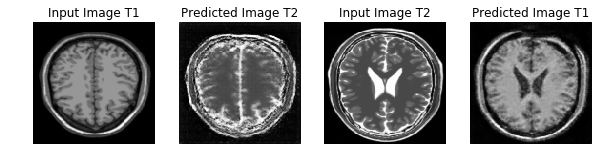

Saving checkpoint for epoch 57 at ./training_checkpoints/CycleGAN_128/ckpt-58


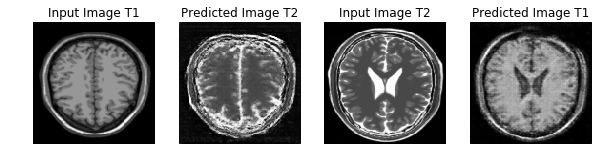

Saving checkpoint for epoch 58 at ./training_checkpoints/CycleGAN_128/ckpt-59


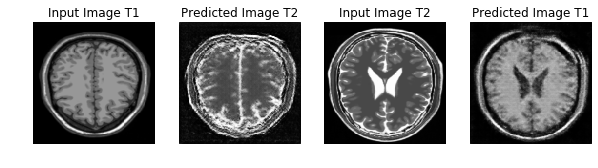

Saving checkpoint for epoch 59 at ./training_checkpoints/CycleGAN_128/ckpt-60


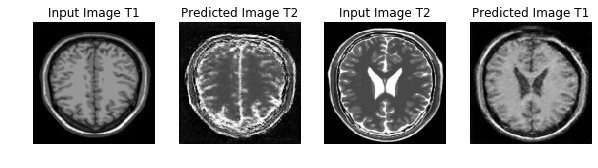

Saving checkpoint for epoch 60 at ./training_checkpoints/CycleGAN_128/ckpt-61


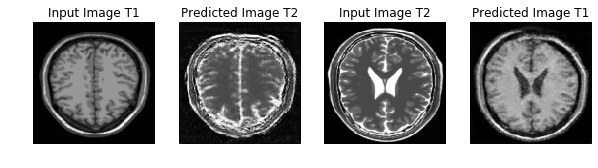

Saving checkpoint for epoch 61 at ./training_checkpoints/CycleGAN_128/ckpt-62


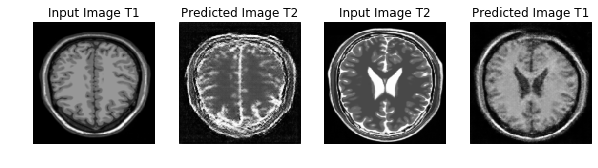

Saving checkpoint for epoch 62 at ./training_checkpoints/CycleGAN_128/ckpt-63


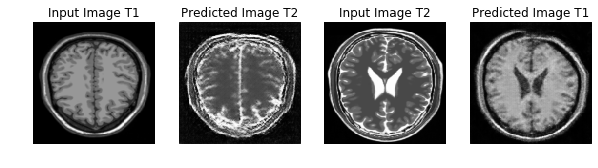

Saving checkpoint for epoch 63 at ./training_checkpoints/CycleGAN_128/ckpt-64


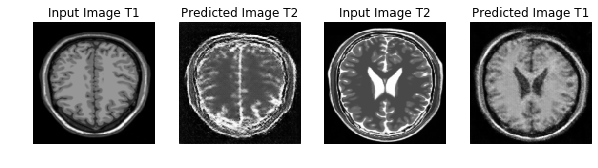

Saving checkpoint for epoch 64 at ./training_checkpoints/CycleGAN_128/ckpt-65


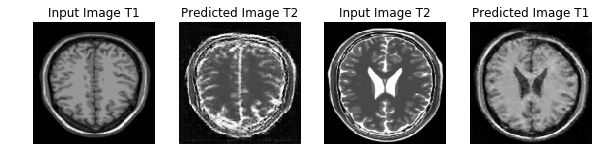

Saving checkpoint for epoch 65 at ./training_checkpoints/CycleGAN_128/ckpt-66


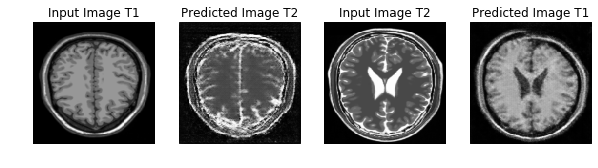

Saving checkpoint for epoch 66 at ./training_checkpoints/CycleGAN_128/ckpt-67


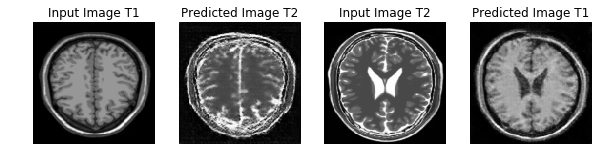

Saving checkpoint for epoch 67 at ./training_checkpoints/CycleGAN_128/ckpt-68


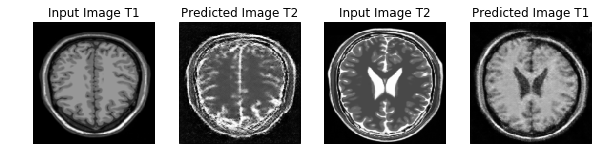

Saving checkpoint for epoch 68 at ./training_checkpoints/CycleGAN_128/ckpt-69


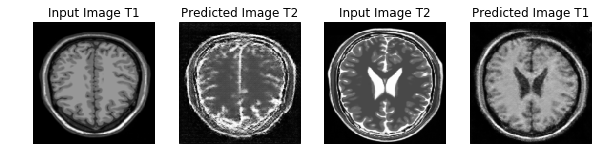

Saving checkpoint for epoch 69 at ./training_checkpoints/CycleGAN_128/ckpt-70


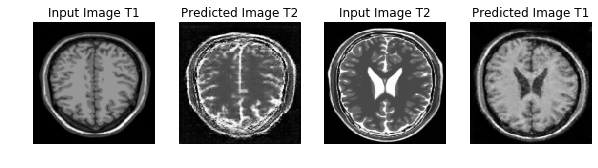

Saving checkpoint for epoch 70 at ./training_checkpoints/CycleGAN_128/ckpt-71


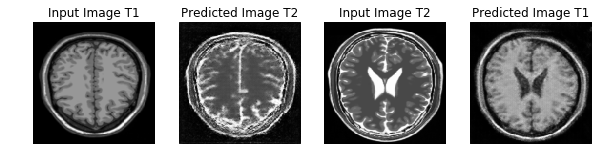

Saving checkpoint for epoch 71 at ./training_checkpoints/CycleGAN_128/ckpt-72


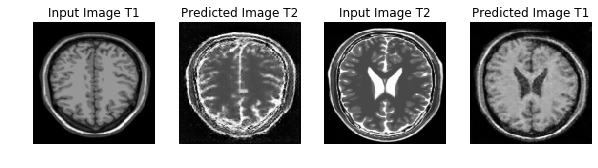

Saving checkpoint for epoch 72 at ./training_checkpoints/CycleGAN_128/ckpt-73


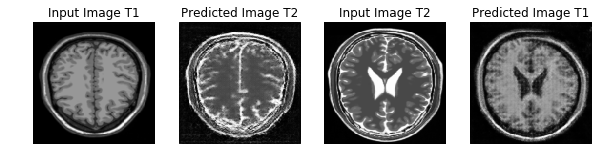

Saving checkpoint for epoch 73 at ./training_checkpoints/CycleGAN_128/ckpt-74


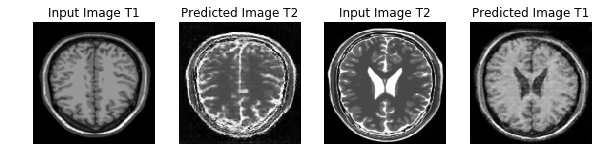

Saving checkpoint for epoch 74 at ./training_checkpoints/CycleGAN_128/ckpt-75


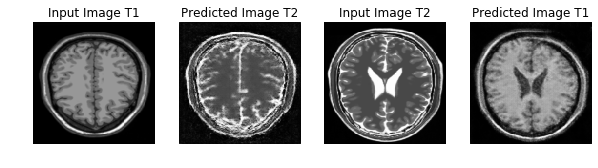

Saving checkpoint for epoch 75 at ./training_checkpoints/CycleGAN_128/ckpt-76


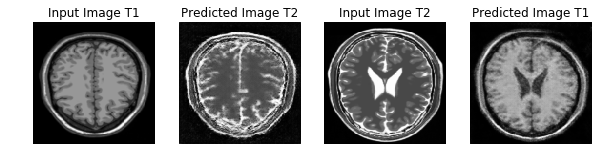

Saving checkpoint for epoch 76 at ./training_checkpoints/CycleGAN_128/ckpt-77


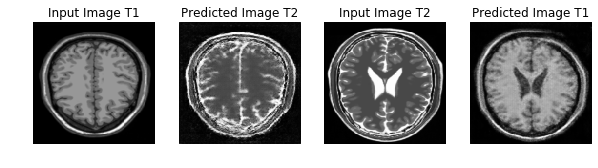

Saving checkpoint for epoch 77 at ./training_checkpoints/CycleGAN_128/ckpt-78


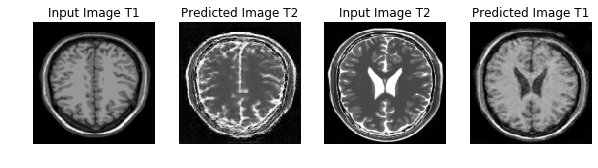

Saving checkpoint for epoch 78 at ./training_checkpoints/CycleGAN_128/ckpt-79


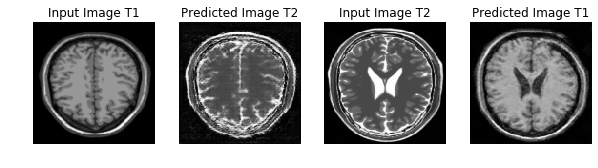

Saving checkpoint for epoch 79 at ./training_checkpoints/CycleGAN_128/ckpt-80


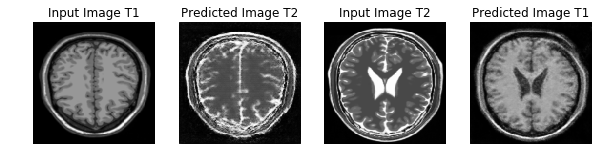

Saving checkpoint for epoch 80 at ./training_checkpoints/CycleGAN_128/ckpt-81


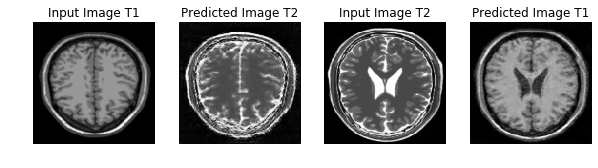

Saving checkpoint for epoch 81 at ./training_checkpoints/CycleGAN_128/ckpt-82


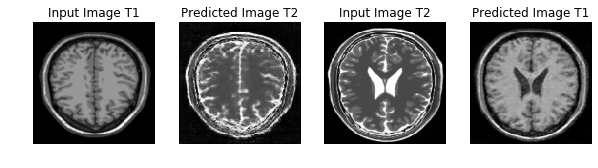

Saving checkpoint for epoch 82 at ./training_checkpoints/CycleGAN_128/ckpt-83


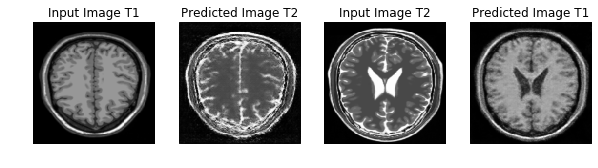

Saving checkpoint for epoch 83 at ./training_checkpoints/CycleGAN_128/ckpt-84


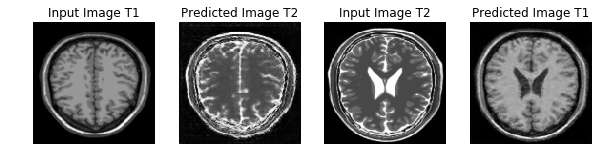

Saving checkpoint for epoch 84 at ./training_checkpoints/CycleGAN_128/ckpt-85


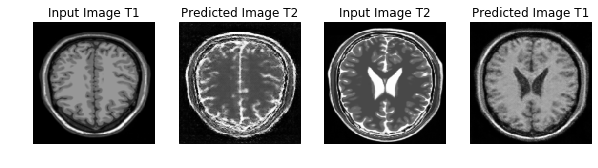

Saving checkpoint for epoch 85 at ./training_checkpoints/CycleGAN_128/ckpt-86


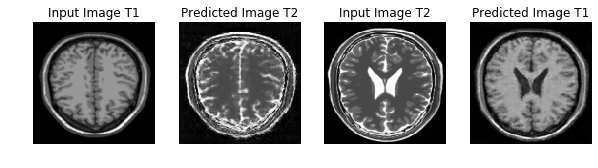

Saving checkpoint for epoch 86 at ./training_checkpoints/CycleGAN_128/ckpt-87


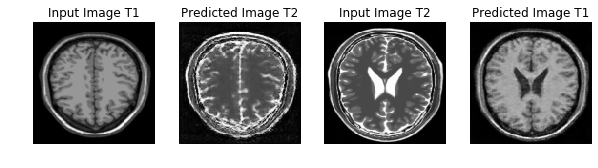

Saving checkpoint for epoch 87 at ./training_checkpoints/CycleGAN_128/ckpt-88


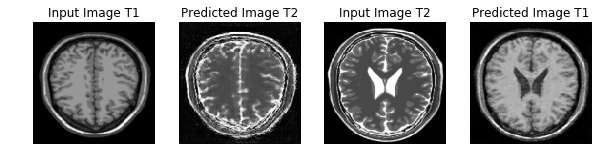

Saving checkpoint for epoch 88 at ./training_checkpoints/CycleGAN_128/ckpt-89


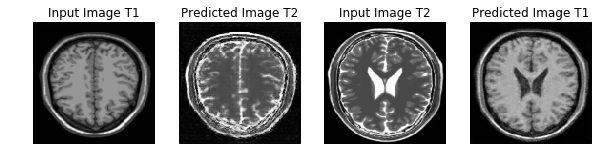

Saving checkpoint for epoch 89 at ./training_checkpoints/CycleGAN_128/ckpt-90


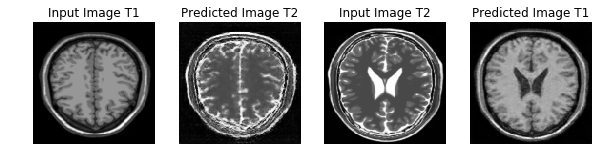

Saving checkpoint for epoch 90 at ./training_checkpoints/CycleGAN_128/ckpt-91


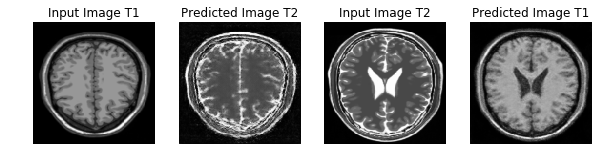

Saving checkpoint for epoch 91 at ./training_checkpoints/CycleGAN_128/ckpt-92


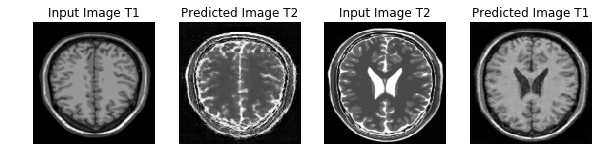

Saving checkpoint for epoch 92 at ./training_checkpoints/CycleGAN_128/ckpt-93


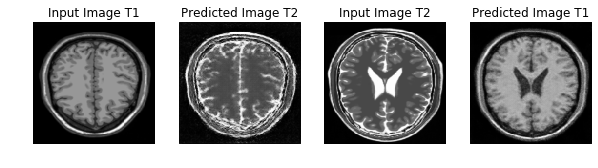

Saving checkpoint for epoch 93 at ./training_checkpoints/CycleGAN_128/ckpt-94


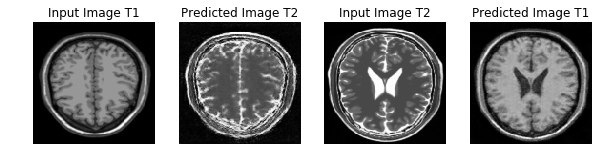

Saving checkpoint for epoch 94 at ./training_checkpoints/CycleGAN_128/ckpt-95


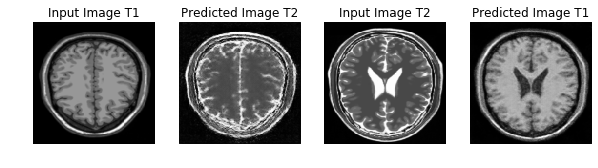

Saving checkpoint for epoch 95 at ./training_checkpoints/CycleGAN_128/ckpt-96


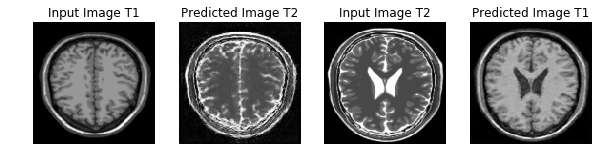

Saving checkpoint for epoch 96 at ./training_checkpoints/CycleGAN_128/ckpt-97


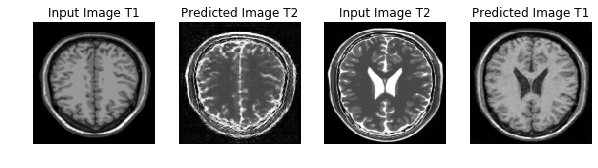

Saving checkpoint for epoch 97 at ./training_checkpoints/CycleGAN_128/ckpt-98


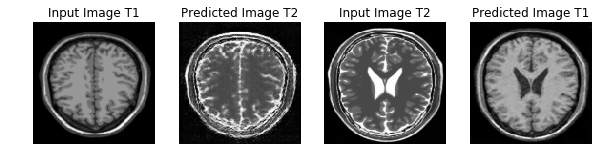

Saving checkpoint for epoch 98 at ./training_checkpoints/CycleGAN_128/ckpt-99


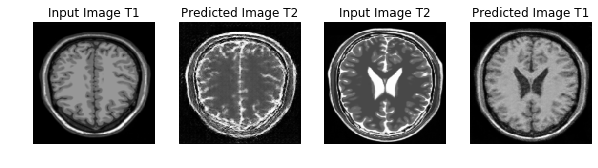

Saving checkpoint for epoch 99 at ./training_checkpoints/CycleGAN_128/ckpt-100


In [46]:
for epoch in range(epochs):
    for image_x, image_y in tf.data.Dataset.zip((tr1_training_resized, tr2_training_resized)):
        train_step(image_x, image_y)
    
    generate_images(generator_g_128, sample_test_1,generator_f_128, sample_test_2,epoch)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

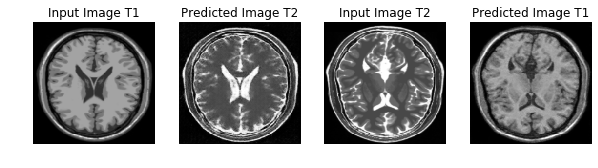

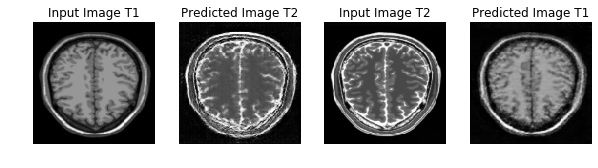

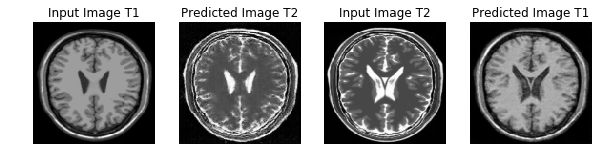

In [47]:
# Run the trained zip on the test dataset
for inp1,inp2 in zip(tr1_test_resized.take(5),tr2_test_resized.take(5)):
    generate_images(generator_g_128, inp1, generator_f_128,inp2,None)

#### Create a `movie_128.gif` from the images stored in the output directory

In [68]:
import glob
from PIL import Image

# filepaths
fp_in = "./Outputs_128/epoch_*.png"
fp_out = "movie_128.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif

img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]

img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=1000, loop=0)

In [74]:
from PIL import Image, ImageSequence

# Output (max) size
size = 1000, 500

# Open source
im = Image.open("movie_128.gif")

# Get sequence iterator
frames = ImageSequence.Iterator(im)

# Wrap on-the-fly thumbnail generator
def thumbnails(frames):
    for frame in frames:
        thumbnail = frame.copy()
        thumbnail.thumbnail(size, Image.ANTIALIAS)
        yield thumbnail

frames = thumbnails(frames)

# Save output
om = next(frames) # Handle first frame separately
om.info = im.info # Copy sequence info
om.save("movie_128_.gif", save_all=True, append_images=list(frames))

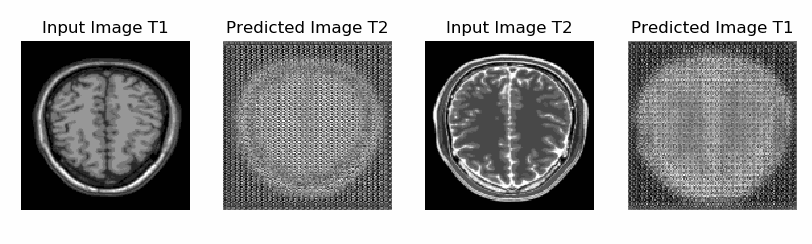

In [66]:
from IPython.display import Image
Image(filename='../checkpoints/movie_128.gif') 

## Training the same network using (256*256) images

## Image Processing 
1.Create a function to process your images with normalisation

2.Apply the function to both the datasets 

3.Visualise the MRI images after processing




#### Normalize the image so that the values are between -1.0 and 1.0

#### Function `resize_datasets` is used to resize the images from (217,181) to (256,256)

In [45]:
def resize_datasets_256(dataset):
    resized = np.zeros((len(dataset),256,256))
    for i,image in enumerate(dataset):
        resized[i,:,:]= st.resize(image,output_shape=(256,256))
    return resized

In [46]:
tr1_training_resized = resize_datasets_256(tr1_training_normalized)
tr2_training_resized = resize_datasets_256(tr2_training_normalized)
tr1_test_resized = resize_datasets_256(tr1_test_normalized)
tr2_test_resized = resize_datasets_256(tr2_test_normalized)

In [47]:
print('T1 training_resized Shape - ',tr1_training_resized.shape)
print('T2 training_resized Shape - ',tr2_training_resized.shape)
print('T1 test_resized Shape - ',tr1_test_resized.shape)
print('T2 test_resized Shape - ',tr2_test_resized.shape)

T1 training_resized Shape -  (35, 256, 256)
T2 training_resized Shape -  (37, 256, 256)
T1 test_resized Shape -  (8, 256, 256)
T2 test_resized Shape -  (9, 256, 256)


In [48]:
tr1_training_resized =tf.cast(tr1_training_resized.reshape(tr1_training_resized.shape[0],256,256,1),tf.float32)
tr2_training_resized = tf.cast(tr2_training_resized.reshape(tr2_training_resized.shape[0],256,256,1),tf.float32)

tr1_test_resized =tf.cast(tr1_test_resized.reshape(tr1_test_resized.shape[0],256,256,1),tf.float32)
tr2_test_resized = tf.cast(tr2_test_resized.reshape(tr2_test_resized.shape[0],256,256,1),tf.float32)

#### Take the sample images from tr1_resized to plot and visualize the pick later

In [49]:
sample_tr1_resized = next(iter(tr1_training_resized))
sample_tr2_resized = next(iter(tr2_training_resized))

In [50]:
sample_tr1_resized=tf.reshape(sample_tr1_resized,(256,256))
sample_tr2_resized=tf.reshape(sample_tr2_resized,(256,256))

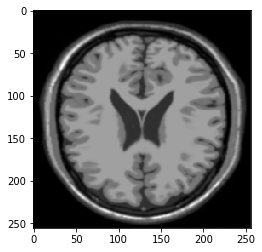

In [54]:
plt.imshow(sample_tr1_resized,cmap='gray')

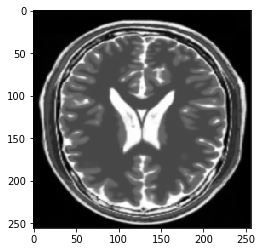

In [55]:
plt.imshow(sample_tr2_resized,cmap='gray')

#### Define the batch size and the epochs

In [51]:
batchsize = 3
epochs = 150

#### Get the data ready in the form of batches by using `from_tensor_slices()` function

In [52]:
tr1_training_resized = tf.data.Dataset.from_tensor_slices(tr1_training_resized).shuffle(tr1_training_normalized.shape[0],seed=42).batch(batchsize)
tr2_training_resized = tf.data.Dataset.from_tensor_slices(tr2_training_resized).shuffle(tr2_training_normalized.shape[0],seed=42).batch(batchsize)

tr1_test_resized = tf.data.Dataset.from_tensor_slices(tr1_test_resized).shuffle(tr1_test_normalized.shape[0],seed=42).batch(batchsize)
tr2_test_resized = tf.data.Dataset.from_tensor_slices(tr2_test_resized).shuffle(tr2_test_normalized.shape[0],seed=42).batch(batchsize)

#### Plot one of the images of both T1 and T2 types

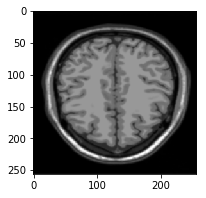

In [53]:
sample_tr1_training = next(iter(tr1_training_resized))
plt.figure(figsize=(3,3))
plt.imshow(sample_tr1_training[0].numpy()[:,:,0],cmap='gray')
plt.show()

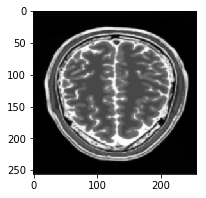

In [59]:
sample_tr2_training = next(iter(tr2_training_resized))
plt.figure(figsize=(3,3))
plt.imshow(sample_tr2_training[0].numpy()[:,:,0],cmap='gray')
plt.show()

In [54]:
def unet_generator_256():
    down_stack = [
        downsample(64,4,False),
        downsample(128,4),
        downsample(128,4),
        downsample(128,4),
        downsample(128,4)]
    up_stack = [
        upsample(128,4,True),
        upsample(128,4,True),
        upsample(128,4),
        upsample(64,4)]
        
    initializer = tf.random_normal_initializer(0., 0.02)
    last = tf.keras.layers.Conv2DTranspose(1, 4, strides=2, padding='same', kernel_initializer=initializer,
                                           activation='tanh') # (bs, 128, 128, 1)
    concat = tf.keras.layers.Concatenate()
    inputs = tf.keras.layers.Input(shape=[256, 256, 1])
    x = inputs
    # Downsampling through the model
    #print(x)
    skips = []
    for down in down_stack:
        x = down(x)
        #print(x)
        skips.append(x)
    skips = reversed(skips[:-1])
    # Upsampling and establishing the skip connections
    for up, skip in zip(up_stack, skips):
        x = up(x)
        #print(x)
        #print('skip =',skip)
        x = concat([x, skip])
    x = last(x)
    return tf.keras.Model(inputs=inputs, outputs=x)

create two generator objects to create a ***cycle***

In [55]:
generator_g_256 = unet_generator_256()#initialise the generator
generator_f_256 = unet_generator_256()#initialise the generator

Print out the summary of one of the generators

In [62]:
generator_g_256.summary()

Model: "model_4"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            [(None, 256, 256, 1) 0                                            
__________________________________________________________________________________________________
sequential_24 (Sequential)      (None, 128, 128, 64) 1024        input_3[0][0]                    
__________________________________________________________________________________________________
sequential_25 (Sequential)      (None, 64, 64, 128)  131328      sequential_24[0][0]              
__________________________________________________________________________________________________
sequential_26 (Sequential)      (None, 32, 32, 128)  262400      sequential_25[0][0]              
____________________________________________________________________________________________

In [56]:
sample_training_1 = next(iter(tr1_training_resized))
sample_training_2 =  next(iter(tr2_training_resized))

In [57]:
sample_test_1 = next(iter(tr1_test_resized))
sample_test_2 =  next(iter(tr2_test_resized))

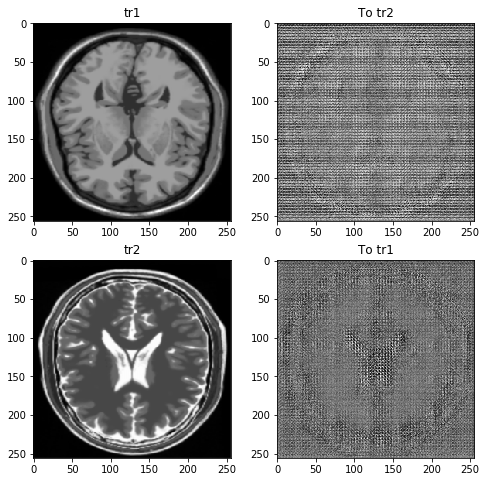

In [58]:
to_tr2 = generator_g_256(sample_training_1)
to_tr1 = generator_f_256(sample_training_2)
plt.figure(figsize=(8, 8))
contrast = 8

imgs = [sample_training_1, to_tr2, sample_training_2, to_tr1]
title = ['tr1', 'To tr2', 'tr2', 'To tr1']

for i in range(len(imgs)):
    plt.subplot(2, 2, i+1)
    plt.title(title[i])
    if i % 2 == 0:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
    else:
        plt.imshow(imgs[i][0].numpy()[:, :, 0] * 0.5 * contrast + 0.5, cmap='gray')
plt.show()

In [59]:
checkpoint_path = './training_checkpoints/CycleGAN_256/'

ckpt = tf.train.Checkpoint(generator_g=generator_g_256,
                           generator_f=generator_f_256,
                           discriminator_x=discriminator_x,
                           discriminator_y=discriminator_y,
                           generator_g_optimizer=generator_g_optimizer,
                           generator_f_optimizer=generator_f_optimizer,
                           discriminator_x_optimizer=discriminator_x_optimizer,
                           discriminator_y_optimizer=discriminator_y_optimizer)

ckpt_manager = tf.train.CheckpointManager(ckpt, checkpoint_path, max_to_keep=epochs)

# if a checkpoint exists, restore the latest checkpoint.
if ckpt_manager.latest_checkpoint:
    ckpt.restore(ckpt_manager.latest_checkpoint)
    print ('Latest checkpoint restored!!')

Latest checkpoint restored!!


#### `generate_images` is used to plot the images while we are training the generators, we can see the progress and transformation of the images from one type to another type and save the images to the `Outputs` directory

In [60]:
def generate_images(model1, test_input1,model2,test_input2,epoch):
    prediction1 = model1(test_input1)
    prediction2 = model2(test_input2)
    plt.figure(figsize=(10, 10))
    display_list = [test_input1[0], prediction1[0], test_input2[0],prediction2[0]]
    title = ['Input Image T1', 'Predicted Image T2','Input Image T2', 'Predicted Image T1']
    for i in range(4):
        plt.subplot(1, 4, i+1)
        plt.title(title[i])
        # getting the pixel values between [0, 1] to plot it.
        plt.imshow(display_list[i].numpy()[:, :, 0] * 0.5 + 0.5, cmap='gray')
        plt.axis('off')
        #plt.savefig('./Outputs/epoch_'+str(epoch)+'.png')
#create Outputs_256 if it does not exist
    Path("Outputs_256").mkdir(parents=True, exist_ok=True)
    plt.savefig('./Outputs_256/epoch_'+str(epoch)+'.png',dpi=100)
    plt.show()


#### Define a `train_step` to perform one step of training

In [61]:
def train_step_256(real_x, real_y):
# Persistance is set to  true because the tape is used more than
# once to calculate the gradients
    with tf.GradientTape(persistent=True) as tape:
# Generate Fake Y and Cycled X
        fake_y = generator_g_256(real_x, training=True)
        cycled_x = generator_f_256(fake_y, training=True)

        # Generate Fake X and Cycled Y
        fake_x = generator_f_256(real_y, training=True)
        cycled_y = generator_g_256(fake_x, training=True)

        # Generate Fake Images through G and F for Identity Loss.
        same_x = generator_f_256(real_x, training=True)
        same_y = generator_g_256(real_y, training=True)

        # Calculate Discriminator prediction using DX and DY on real and fake data for loss calculation.
        disc_real_x = discriminator_x(real_x, training=True)
        disc_real_y = discriminator_y(real_y, training=True)

        disc_fake_x = discriminator_x(fake_x, training=True)
        disc_fake_y = discriminator_y(fake_y, training=True)

        # Calculate Generator Loss on Discriminator.
        gen_g_loss = generator_loss(disc_fake_y)
        gen_f_loss = generator_loss(disc_fake_x)

        # Calculate Cycled Loss on Cycled Images from step 1 and 2.
        total_cycle_loss = calc_cycle_loss(real_x, cycled_x) + calc_cycle_loss(real_y, cycled_y)

        # Calculate Total Generator Loss →  Disc Loss + Cycled Loss + Identity Loss.
        total_gen_g_loss = gen_g_loss + total_cycle_loss + identity_loss(real_y, same_y)
        total_gen_f_loss = gen_f_loss + total_cycle_loss + identity_loss(real_x, same_x)

        # Calculate Discriminator Loss on both Fake and Real Images for Disc X and Y for Disc Training.
        disc_x_loss = discriminator_loss(disc_real_x, disc_fake_x)
        disc_y_loss = discriminator_loss(disc_real_y, disc_fake_y)

# Calculate the Gradients for generator and discriminator
        generator_g_gradients = tape.gradient(total_gen_g_loss, generator_g_256.trainable_variables)
        generator_f_gradients = tape.gradient(total_gen_f_loss, generator_f_256.trainable_variables)

        discriminator_x_gradients = tape.gradient(disc_x_loss, discriminator_x.trainable_variables)
        discriminator_y_gradients = tape.gradient(disc_y_loss, discriminator_y.trainable_variables)

        # Apply the gradients to the optimizer
        generator_g_optimizer.apply_gradients(zip(generator_g_gradients, generator_g_256.trainable_variables))
        generator_f_optimizer.apply_gradients(zip(generator_f_gradients, generator_f_256.trainable_variables))

        discriminator_x_optimizer.apply_gradients(zip(discriminator_x_gradients, discriminator_x.trainable_variables))
        discriminator_y_optimizer.apply_gradients(zip(discriminator_y_gradients, discriminator_y.trainable_variables))

#### Below results are for 128*128 images

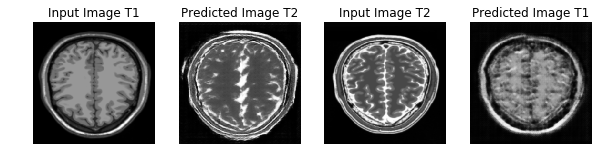

Saving checkpoint for epoch 46 at ./training_checkpoints/CycleGAN_256/ckpt-48


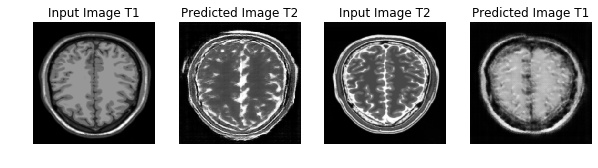

Saving checkpoint for epoch 47 at ./training_checkpoints/CycleGAN_256/ckpt-49


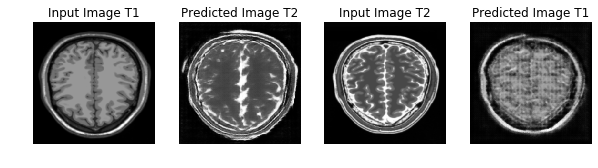

Saving checkpoint for epoch 48 at ./training_checkpoints/CycleGAN_256/ckpt-50


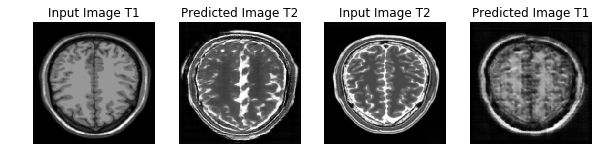

Saving checkpoint for epoch 49 at ./training_checkpoints/CycleGAN_256/ckpt-51


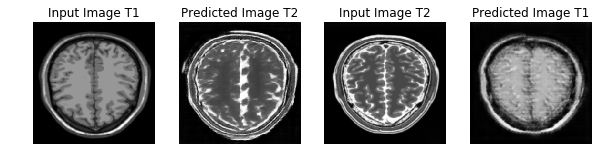

Saving checkpoint for epoch 50 at ./training_checkpoints/CycleGAN_256/ckpt-52


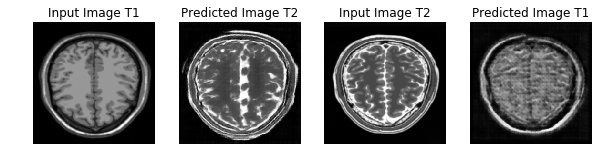

Saving checkpoint for epoch 51 at ./training_checkpoints/CycleGAN_256/ckpt-53


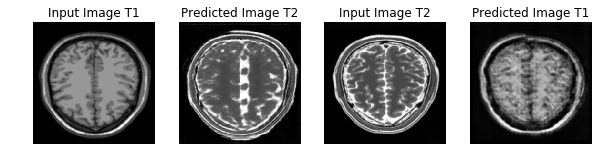

Saving checkpoint for epoch 52 at ./training_checkpoints/CycleGAN_256/ckpt-54


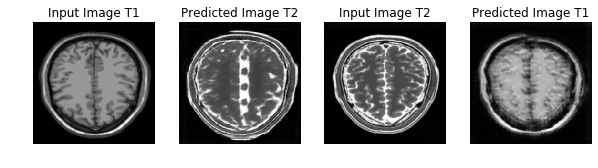

Saving checkpoint for epoch 53 at ./training_checkpoints/CycleGAN_256/ckpt-55


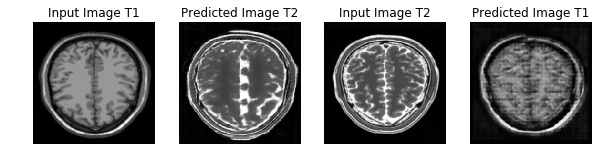

Saving checkpoint for epoch 54 at ./training_checkpoints/CycleGAN_256/ckpt-56


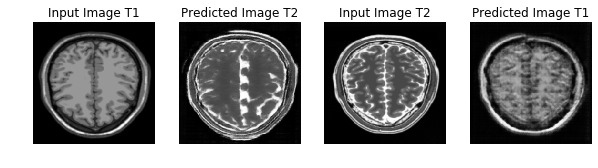

Saving checkpoint for epoch 55 at ./training_checkpoints/CycleGAN_256/ckpt-57


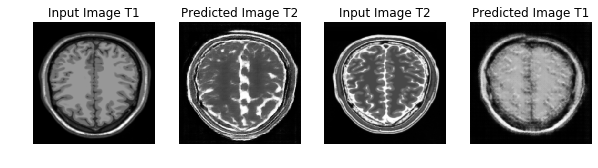

Saving checkpoint for epoch 56 at ./training_checkpoints/CycleGAN_256/ckpt-58


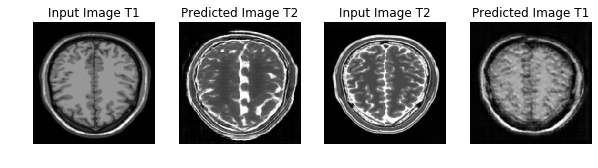

Saving checkpoint for epoch 57 at ./training_checkpoints/CycleGAN_256/ckpt-59


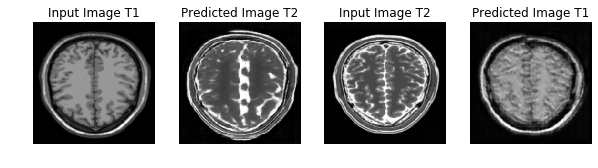

Saving checkpoint for epoch 58 at ./training_checkpoints/CycleGAN_256/ckpt-60


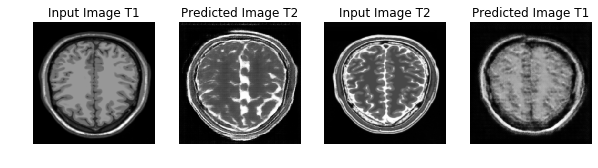

Saving checkpoint for epoch 59 at ./training_checkpoints/CycleGAN_256/ckpt-61


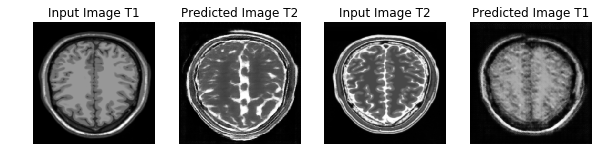

Saving checkpoint for epoch 60 at ./training_checkpoints/CycleGAN_256/ckpt-62


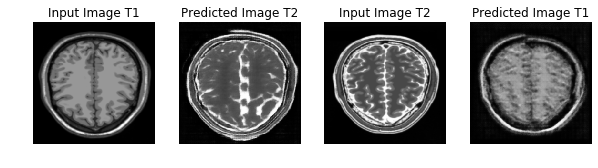

Saving checkpoint for epoch 61 at ./training_checkpoints/CycleGAN_256/ckpt-63


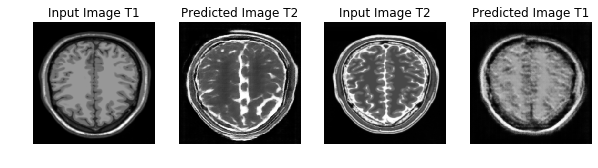

Saving checkpoint for epoch 62 at ./training_checkpoints/CycleGAN_256/ckpt-64


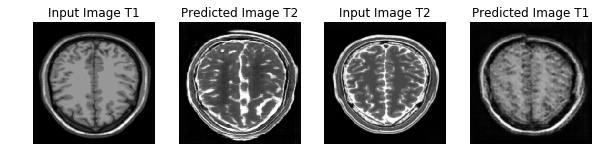

Saving checkpoint for epoch 63 at ./training_checkpoints/CycleGAN_256/ckpt-65


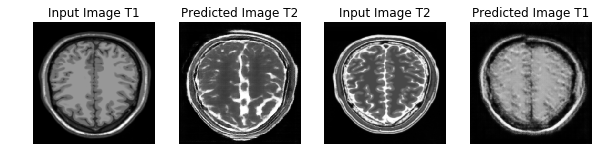

Saving checkpoint for epoch 64 at ./training_checkpoints/CycleGAN_256/ckpt-66


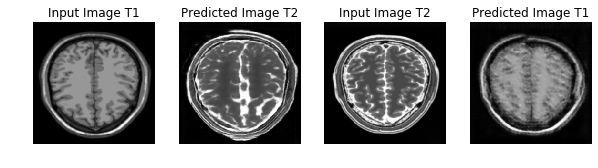

Saving checkpoint for epoch 65 at ./training_checkpoints/CycleGAN_256/ckpt-67


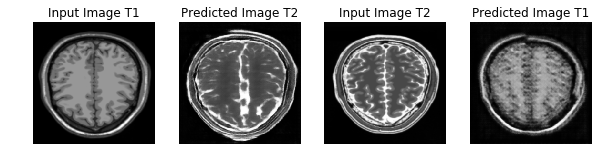

Saving checkpoint for epoch 66 at ./training_checkpoints/CycleGAN_256/ckpt-68


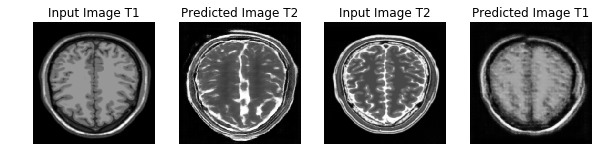

Saving checkpoint for epoch 67 at ./training_checkpoints/CycleGAN_256/ckpt-69


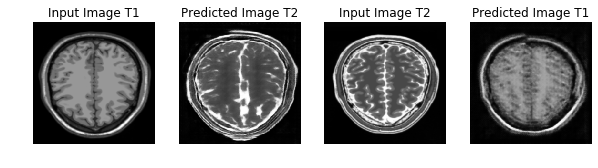

Saving checkpoint for epoch 68 at ./training_checkpoints/CycleGAN_256/ckpt-70


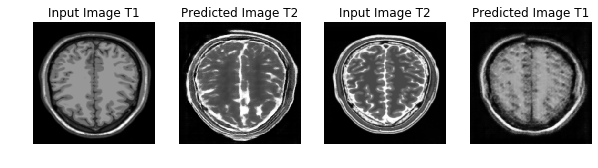

Saving checkpoint for epoch 69 at ./training_checkpoints/CycleGAN_256/ckpt-71


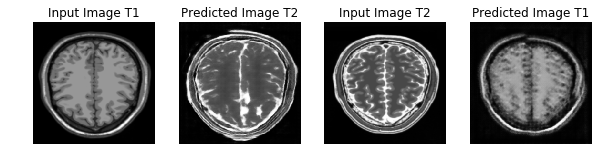

Saving checkpoint for epoch 70 at ./training_checkpoints/CycleGAN_256/ckpt-72


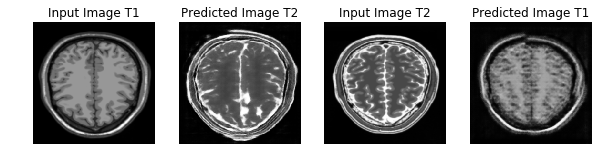

Saving checkpoint for epoch 71 at ./training_checkpoints/CycleGAN_256/ckpt-73


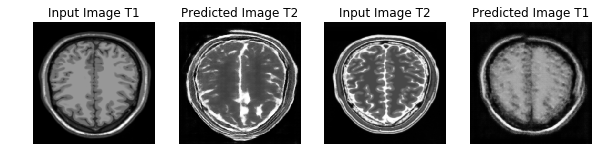

Saving checkpoint for epoch 72 at ./training_checkpoints/CycleGAN_256/ckpt-74


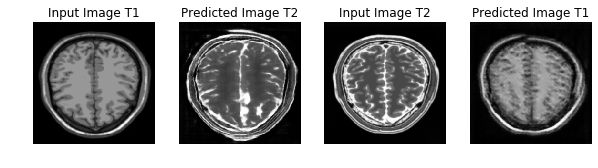

Saving checkpoint for epoch 73 at ./training_checkpoints/CycleGAN_256/ckpt-75


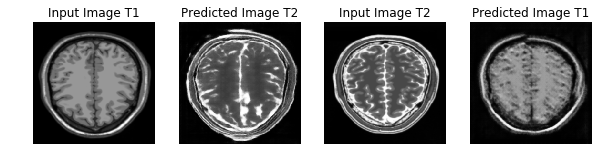

Saving checkpoint for epoch 74 at ./training_checkpoints/CycleGAN_256/ckpt-76


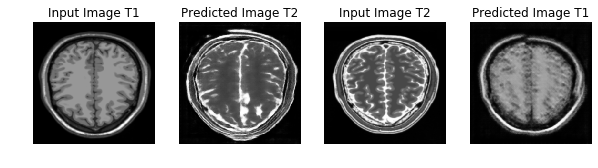

Saving checkpoint for epoch 75 at ./training_checkpoints/CycleGAN_256/ckpt-77


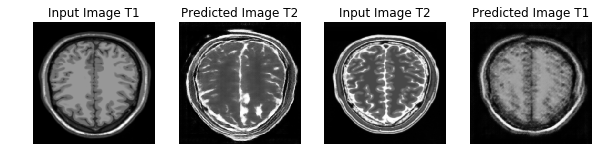

Saving checkpoint for epoch 76 at ./training_checkpoints/CycleGAN_256/ckpt-78


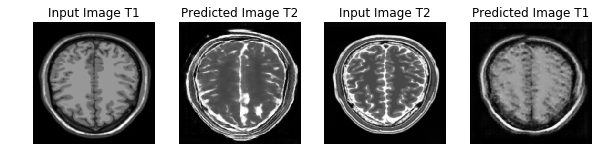

Saving checkpoint for epoch 77 at ./training_checkpoints/CycleGAN_256/ckpt-79


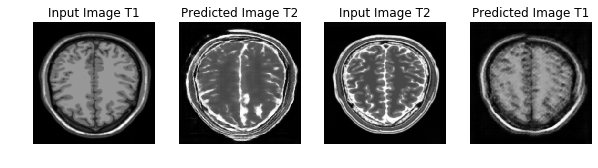

Saving checkpoint for epoch 78 at ./training_checkpoints/CycleGAN_256/ckpt-80


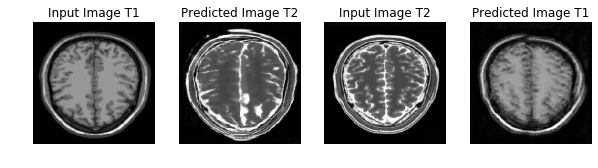

Saving checkpoint for epoch 79 at ./training_checkpoints/CycleGAN_256/ckpt-81


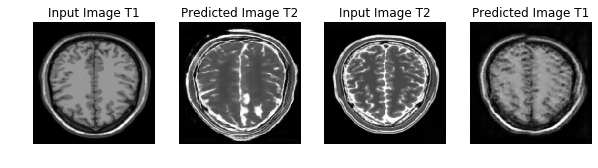

Saving checkpoint for epoch 80 at ./training_checkpoints/CycleGAN_256/ckpt-82


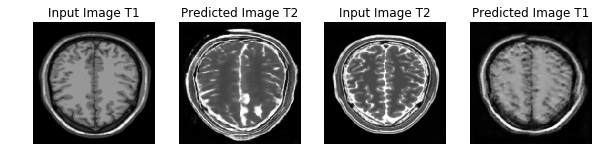

Saving checkpoint for epoch 81 at ./training_checkpoints/CycleGAN_256/ckpt-83


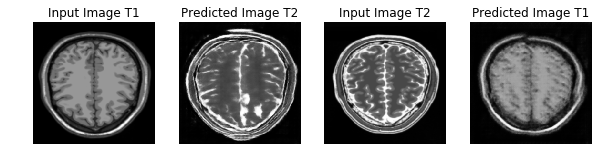

Saving checkpoint for epoch 82 at ./training_checkpoints/CycleGAN_256/ckpt-84


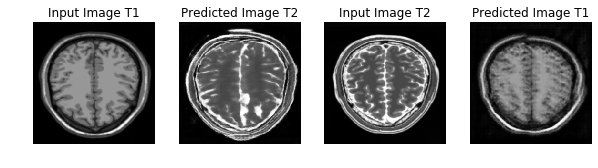

Saving checkpoint for epoch 83 at ./training_checkpoints/CycleGAN_256/ckpt-85


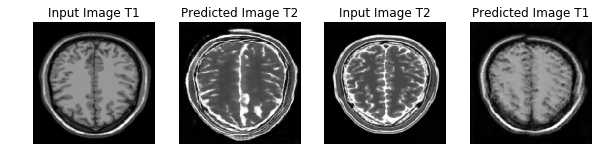

Saving checkpoint for epoch 84 at ./training_checkpoints/CycleGAN_256/ckpt-86


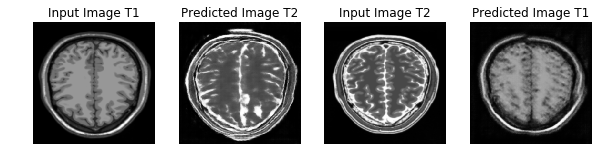

Saving checkpoint for epoch 85 at ./training_checkpoints/CycleGAN_256/ckpt-87


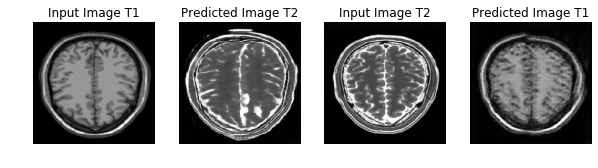

Saving checkpoint for epoch 86 at ./training_checkpoints/CycleGAN_256/ckpt-88


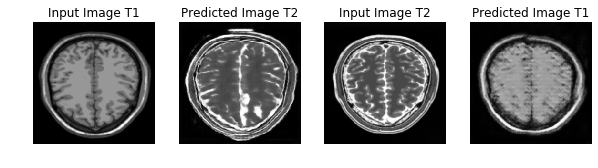

Saving checkpoint for epoch 87 at ./training_checkpoints/CycleGAN_256/ckpt-89


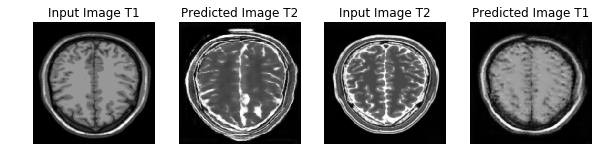

Saving checkpoint for epoch 88 at ./training_checkpoints/CycleGAN_256/ckpt-90


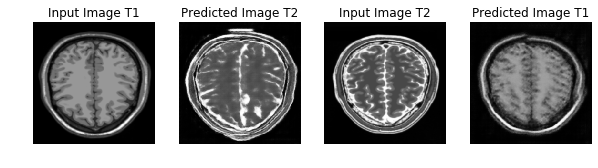

Saving checkpoint for epoch 89 at ./training_checkpoints/CycleGAN_256/ckpt-91


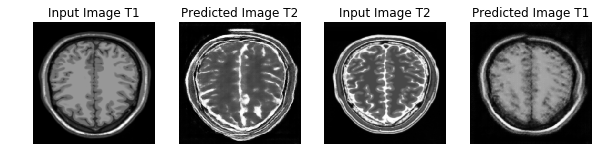

Saving checkpoint for epoch 90 at ./training_checkpoints/CycleGAN_256/ckpt-92


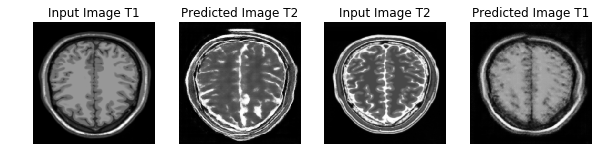

Saving checkpoint for epoch 91 at ./training_checkpoints/CycleGAN_256/ckpt-93


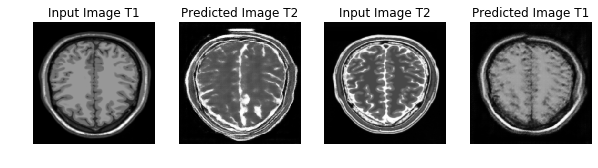

Saving checkpoint for epoch 92 at ./training_checkpoints/CycleGAN_256/ckpt-94


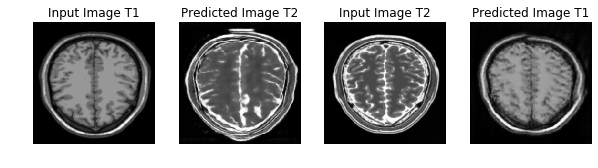

Saving checkpoint for epoch 93 at ./training_checkpoints/CycleGAN_256/ckpt-95


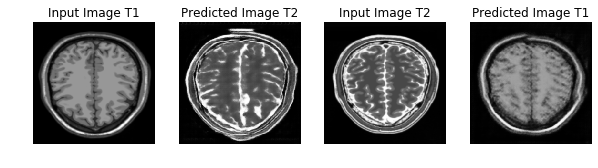

Saving checkpoint for epoch 94 at ./training_checkpoints/CycleGAN_256/ckpt-96


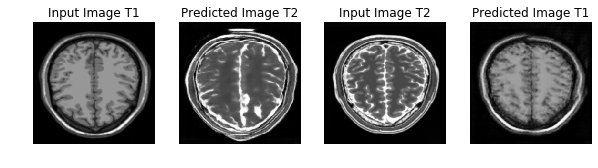

Saving checkpoint for epoch 95 at ./training_checkpoints/CycleGAN_256/ckpt-97


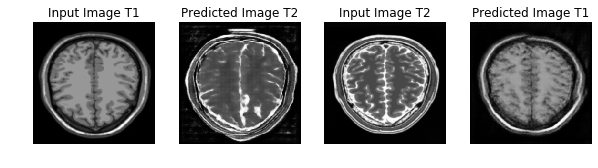

Saving checkpoint for epoch 96 at ./training_checkpoints/CycleGAN_256/ckpt-98


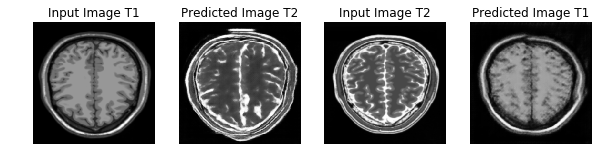

Saving checkpoint for epoch 97 at ./training_checkpoints/CycleGAN_256/ckpt-99


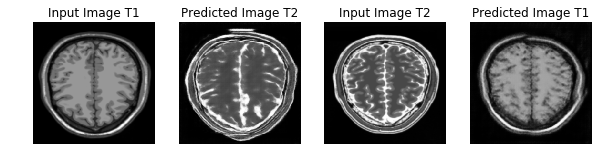

Saving checkpoint for epoch 98 at ./training_checkpoints/CycleGAN_256/ckpt-100


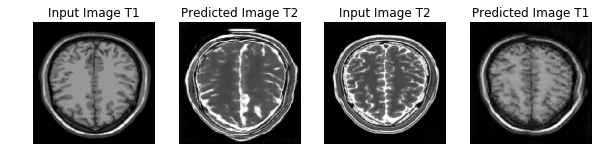

Saving checkpoint for epoch 99 at ./training_checkpoints/CycleGAN_256/ckpt-101


In [74]:
for epoch in range(epochs):
    for image_x, image_y in tf.data.Dataset.zip((tr1_training_resized, tr2_training_resized)):
        train_step_256(image_x, image_y)
    
    generate_images(generator_g_256, sample_test_1,generator_f_256, sample_test_2,epoch)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)

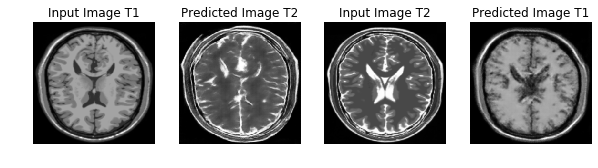

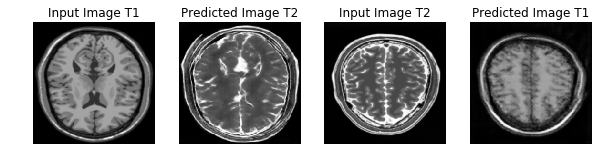

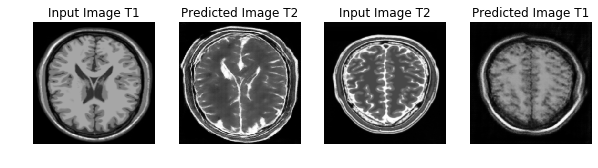

In [76]:
for epoch in range(46,100):
    for image_x, image_y in tf.data.Dataset.zip((tr1_training_resized, tr2_training_resized)):
        train_step_256(image_x, image_y)
    
    generate_images(generator_g_256, sample_test_1,generator_f_256, sample_test_2,epoch)
    ckpt_save_path = ckpt_manager.save()
    print('Saving checkpoint for epoch', epoch, 'at', ckpt_save_path)# Run the trained zip on the test dataset
for inp1,inp2 in zip(tr1_test_resized.take(5),tr2_test_resized.take(5)):
    generate_images(generator_g_256, inp1, generator_f_256,inp2,None)

In [77]:
import glob
from PIL import Image

# filepaths
fp_in = "./Outputs_256/epoch_*.png"
fp_out = "movie_256.gif"

# https://pillow.readthedocs.io/en/stable/handbook/image-file-formats.html#gif
img, *imgs = [Image.open(f) for f in sorted(glob.glob(fp_in))]
img.save(fp=fp_out, format='GIF', append_images=imgs,
         save_all=True, duration=200, loop=0)

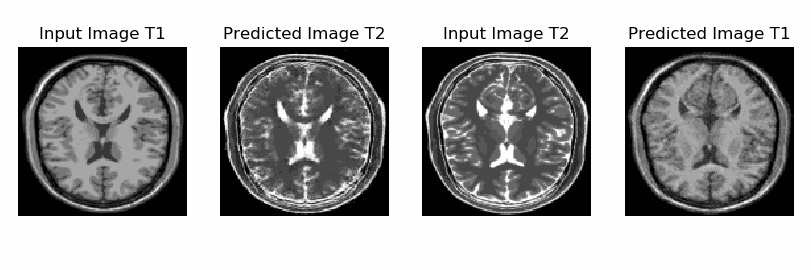

In [78]:
from IPython.display import Image
Image(filename='../checkpoints/movie_256.gif') 

# The checkpoints for (128,128) and (256,256) are stored in <a href ="https://drive.google.com/drive/folders/1c4vQBRqz6zhvPBesP3OnmCEiPNuS1kEq" style="color: #FF0000"> here</a>